<a href="https://colab.research.google.com/github/sumedhsp/ComputerVisionWorkspace/blob/main/Project%201/CV_Project_I.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [ ]:
# Import all the related libraries here
import cv2
import numpy as np
import matplotlib.pyplot as plt

# 1. Histogram Equalization

**Histogram of an image:**
Histogram of an image comprises of a frequency count of the different intensities grouped by the bin width. Histograms help us analyze the distribution of the intensities and assist in further image processing. It helps us understand how we can proceed with image processing, for instance in the below case, we use histogram to understand the distribution and then process the image to brighten the dark pixels allowing us to capture more information. In addition, they also help us to identify number of peaks, uniformity allowing us to conclude about the brightness and contrast properties of the image.

In [ ]:
# Load image
image = cv2.imread('/content/detective.png', cv2.IMREAD_GRAYSCALE)

In [ ]:
# Size of the image
print ("Image size: " + str(image.size))

Image size: 65536


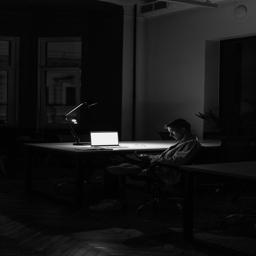

In [ ]:
# Displaying the Detective image.
from google.colab.patches import cv2_imshow
cv2_imshow(image)

In [ ]:
# Define a function that returns the pdf of the input image
def create_pdf(im_in):
  # We define an pdf numpy array to be used as a hashmap to store the frequencies.
  pdf = np.zeros(256)

  for i in range(len(im_in)):
    for j in range(len(im_in[i])):
      pdf[im_in[i][j]] += 1

  return pdf

In [ ]:
# Define a function that returns the cdf of the pdf of the image
def create_cdf(pdf):
  # We process the pdf to form a cumulative distribution
  cdf = np.zeros(256)

  cdf[0] = pdf[0]
  for i in range(1, len(pdf)):
    cdf[i] = cdf[i-1] + pdf[i]

  return cdf

In [ ]:
# Define the function that applies "Histogram equalization" on a given input image
def histogram_equalization(im_in):
  pdf = create_pdf(im_in)
  # Normalize the pdf before proceeding with further processing
  pdf = pdf / im_in.size
  cdf = create_cdf(pdf)

  cdf = cdf*255
  cdf = np.round(cdf).astype('uint8')

  eq_im = cdf[im_in]

  return eq_im

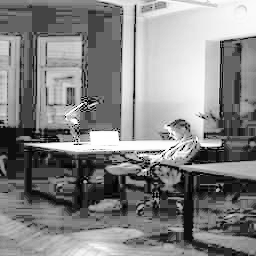

In [ ]:
new_image = histogram_equalization(image)

# New image after histogram equalization
cv2_imshow(new_image)

Text(0.5, 1.0, 'CDF plot (After histogram eq)')

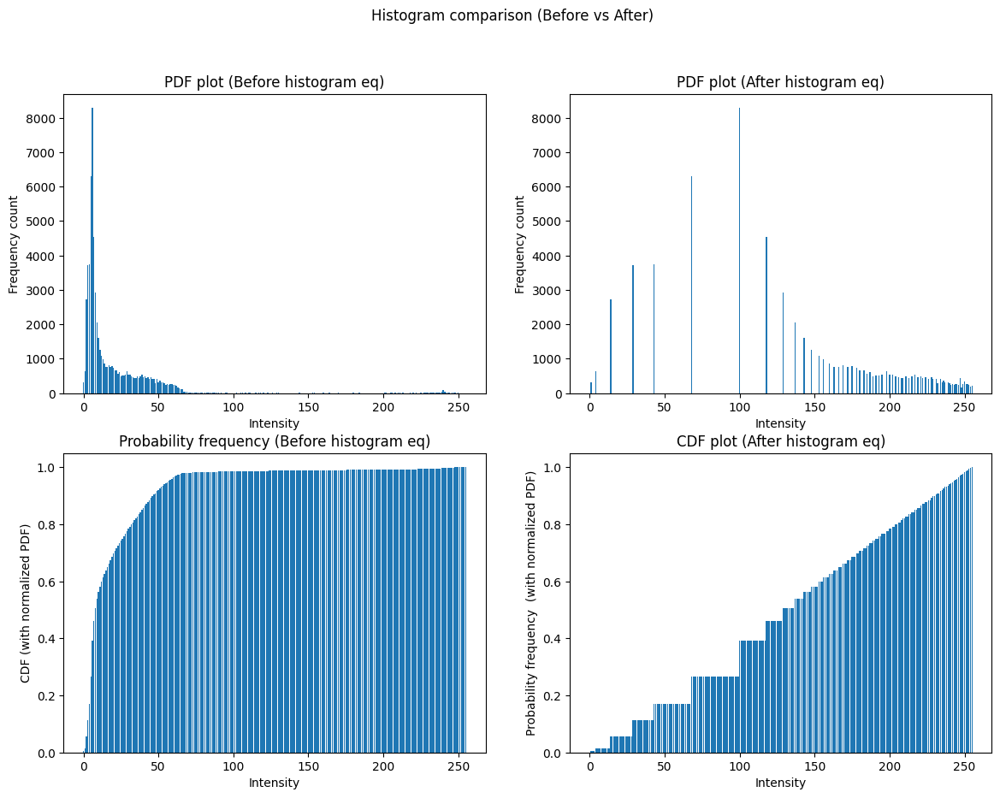

In [ ]:
# Plot the pdf, cdf and image before and after histogram equalization
# Before v/s After histogram equilization

plt.figure(figsize=(14,10))
plt.suptitle('Histogram comparison (Before vs After)')

plt.subplot(2, 2, 1)
pdf = create_pdf(image)
plt.bar(range(256), pdf)
plt.xlabel('Intensity')
plt.ylabel('Frequency count')
plt.title('PDF plot (Before histogram eq)')


plt.subplot(2, 2, 2)
pdf_after = create_pdf(new_image)
plt.bar(range(256), pdf_after)
plt.xlabel('Intensity')
plt.ylabel('Frequency count')
plt.title('PDF plot (After histogram eq)')


plt.subplot(2, 2, 3)
# Normalize the pdf
pdf = pdf / image.size
cdf = create_cdf(pdf)
plt.bar(range(256), cdf)
plt.xlabel('Intensity')
plt.ylabel('CDF (with normalized PDF)')
plt.title('Probability frequency (Before histogram eq)')


plt.subplot(2, 2, 4)
# Normalize the pdf
pdf_after = pdf_after / new_image.size
cdf_after = create_cdf(pdf_after)
plt.bar(range(256), cdf_after)
plt.xlabel('Intensity')
plt.ylabel('Probability frequency  (with normalized PDF)')
plt.title('CDF plot (After histogram eq)')

**Provide a detailed comparative discussion of the PDF and CDF plots. Relate them to the Image's contrast and density.**

> *We can observe from the plot above that the pdf and cdf of the image prior histogram equalization are different indicating that the image has changed. We can validate that through viewing the new image where we can effectively see that the man is sitting on a chair.*
>> *Before Histogram equalization : We can notice that the major PDF distribution of the intensities is mostly on the lower intensities highlighting that the overall image has lot of dark pixels making the image collectively dark. And because of this, in the cumulative distribution, we observe that we reach value 1 (because we are using probability) very early in the intensity.*

>> *After histogram equalization : We can notice from the PDF plot that the intensities are more distributed and spread out compared to prior processing indicating that we have eliminated some dark pixels. We also notice a uniform increase in the cumulative distribution when compare to the prior graph where we had many dark pixels. In this particular scenario, we have reduced the dark pixel intensities thus allowing us to notice some of the dark pixels roughly which were not evident early.*

# 2. Image Thresholding

In [ ]:
# Load image
image = cv2.imread('/content/TEM cell.png', cv2.IMREAD_GRAYSCALE)

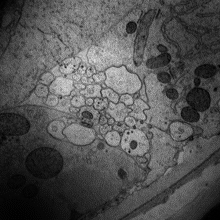

In [ ]:
cv2_imshow(image)

Text(0.5, 1.0, 'PDF plot (Histogram)')

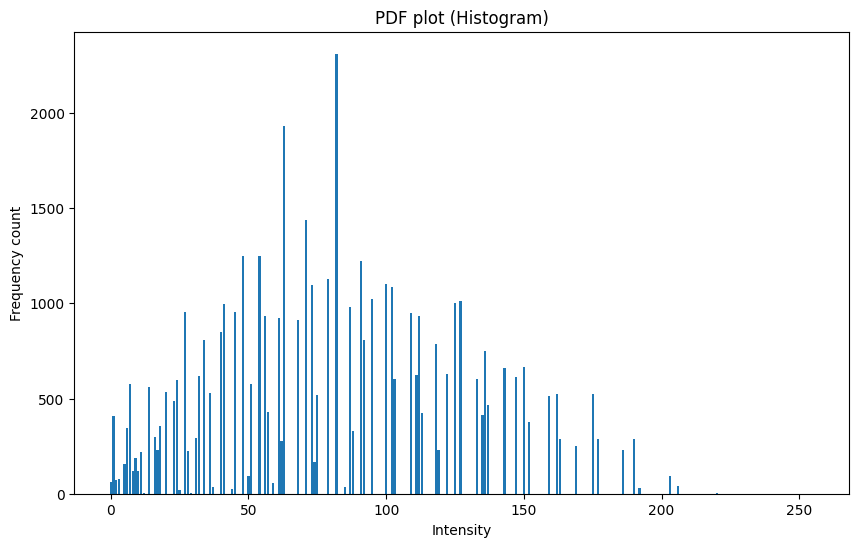

In [ ]:
# Plot the histogram of the image using the functions you created for Q1
plt.figure(figsize=(10, 6))

pdf = create_pdf(image)
plt.bar(range(256), pdf)
plt.xlabel('Intensity')
plt.ylabel('Frequency count')
plt.title('PDF plot (Histogram)')

In [ ]:
# Apply Otsu Thresholding and generate a plot of the inter-class variance
def otsu_thresholding(im_in):
  pdf = create_pdf(im_in)
  std_dev = []

  max_, threshold = 0, 0
  sum_bg, sum_fg = 0, 0
  total_sum = 0

  for i in range(len(pdf)):
    total_sum += (pdf[i]) * i

  wb, wf = 0, np.sum(pdf)

  for i in range(len(pdf)):
    # wb * wf (Mb - Mf)**2
    wb += pdf[i]
    wf -= pdf[i]

    if (wf == 0):
      # We don't want to continue as
      # we'll get an error in computation
      break

    sum_bg += pdf[i]*i
    mean_bg = sum_bg / wb

    mean_fg = (total_sum - sum_bg) / wf

    std_ = wb * wf * (mean_bg - mean_fg)**2

    if (std_ > max_ ):
      max_ = std_
      threshold = i
    std_dev.append(std_)

  return std_dev, max_, threshold


Max Std deviation: 3201454513223.568 Threshold value: 85


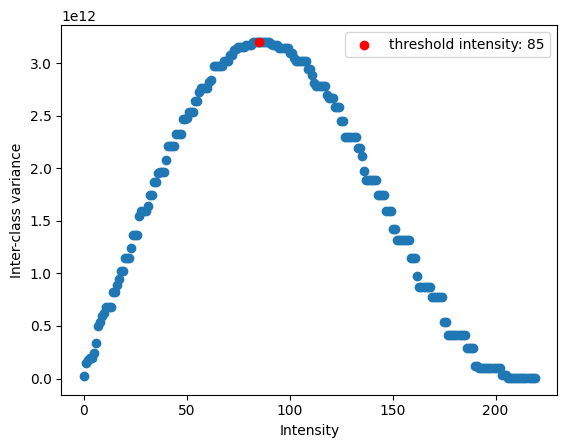

In [ ]:
dev, max_, threshold = otsu_thresholding(image)

print ("Max Std deviation: " + str(max_), "Threshold value: " + str(threshold))


plt.scatter(range(220), dev)
# We can notice the maximum value highlighted in red
plt.scatter(threshold, max_, color='red', label='threshold intensity: ' + str(threshold))
plt.xlabel('Intensity')
plt.ylabel('Inter-class variance')
plt.legend()
plt.show()

**Display the Otsu thresholded image and discuss the results**

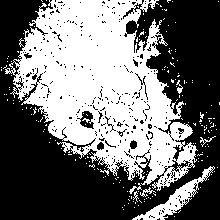

In [ ]:
new_image = np.where(image >= threshold, 255, 0)

cv2_imshow(new_image)

> *Otsu's threshold algorithm automatically finds an optimal threshold intensity by computing variance across all the possible threshold and using the one which has maximized variance across the image.*
*In the above output, we are able to deduce cell borders only in the middle ignoring the cells in the darker background, because of the threshold value. This is not the most optimal result generated using the Otsu's algorithm.*

> *Otsu's algortihm does not work well when the object intensities of some of the cells are dim characterizing them as a dark pixel after thresholding. As the algorithm is known to perform well as a global thresholding algorithm, but because of some local nuances in intensities and illumination we ignore them. The algorithm is also known to work well with images having a bi-modal distribution, and our image does not have a bimodal distribution.*

In [ ]:
# Implement Niblack's Thresholding Algorithm
def niblack_thresholding(im_in, window_size, k):

  new_image = np.pad(im_in, pad_width = window_size//2)
  height, width = im_in.shape

  threshold_image = np.zeros(im_in.shape, dtype='uint8')

  for i in range(height):
    for j in range(width):
      temp = new_image[i:i+window_size, j:j+window_size]

      mean_ = np.mean(temp)
      std_ = np.std(temp)

      threshold_val = mean_ + (k * std_)

      if (im_in[i][j] >= threshold_val):
        threshold_image[i][j] = 255
      else:
        threshold_image[i][j] = 0


  return threshold_image

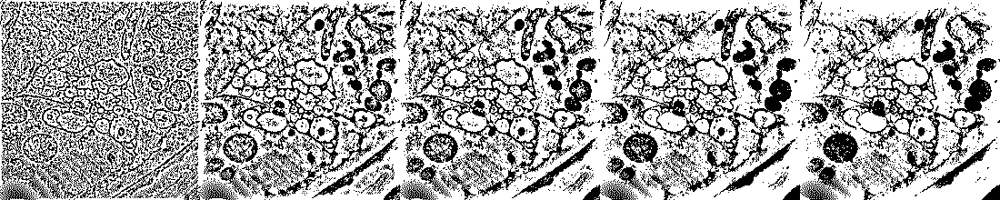

In [ ]:
window_sizes = [5, 15, 21, 33, 45]

new_image_final = None

for size in window_sizes:
  new_image = niblack_thresholding(image, size, -0.2)

  if (new_image_final is None):
    new_image_final = new_image
  else:
    new_image_final = np.hstack((new_image_final, new_image))

cv2_imshow(new_image_final)

Window size : 5


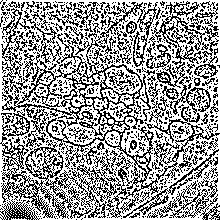



Window size : 15


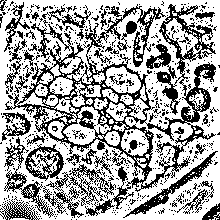



Window size : 21


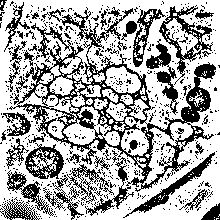



Window size : 33


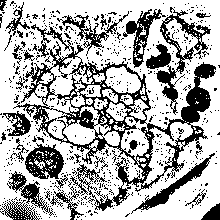



Window size : 45


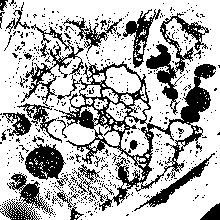

In [ ]:
window_sizes = [5, 15, 21, 33, 45]

for size in window_sizes:
  new_image = niblack_thresholding(image, size, -0.2)
  print ("Window size : " + str(size))

  cv2_imshow(new_image)
  print ("\n")

> *We can notice the borders of the image in all the outputs above. We can infer that as we increase the window sizes, we incorporate more data to compute the local thresholding allowing us to capture the borders more effectively*
> *We can observe the image becoming more clearer with less noise.*

**Discuss the outputs of the two thresholded images based on the results you got**

> *The two thresholding algorithms have their own strengths. Otsu's algorithm known as a global thresholding algorithm determines the threshold by accounting the entire image and calculating a threshold value. But sometimes, the areas of the image which are dim are ignored because of this and create problems when retrieving key information from the image. This can be observed from the image output before the Niblack algorithm section.*

>*On the other hand, Niblack algorithm performs thresholding by only accounting for local thresholding thus adapting and identifying information from the dim regions of the images. The window sizes can be adjusted according to the requirement and from the results above we can notice that Niblack algorithm performs better for this particular image because of that reason.*

# 3. Template Matching

In [ ]:
# Load "colored" image
main_image = cv2.imread('/content/snow.jpg')
template_image = cv2.imread('/content/snowtemp.jpg')

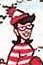

In [ ]:
cv2_imshow(template_image)

In [ ]:
# Create a function to perform template matching
def template_matching(main_image, template_image):
  height, width, color = main_image.shape
  dl, dw, dr = template_image.shape

  template_normalized = template_image - np.mean(template_image)
  main_image_normalized = main_image - np.mean(main_image)

  cross_correlation = np.zeros((height-dl+1, width-dw+1))

  for i in range(height - dl + 1):
    for j in range(width - dw + 1):
      temp = main_image_normalized[i:i+dl, j:j+dw]
      corr = np.sum(template_normalized * temp)
      cross_correlation[i][j] = corr

  return cross_correlation

In [ ]:
corr = template_matching(main_image, template_image)

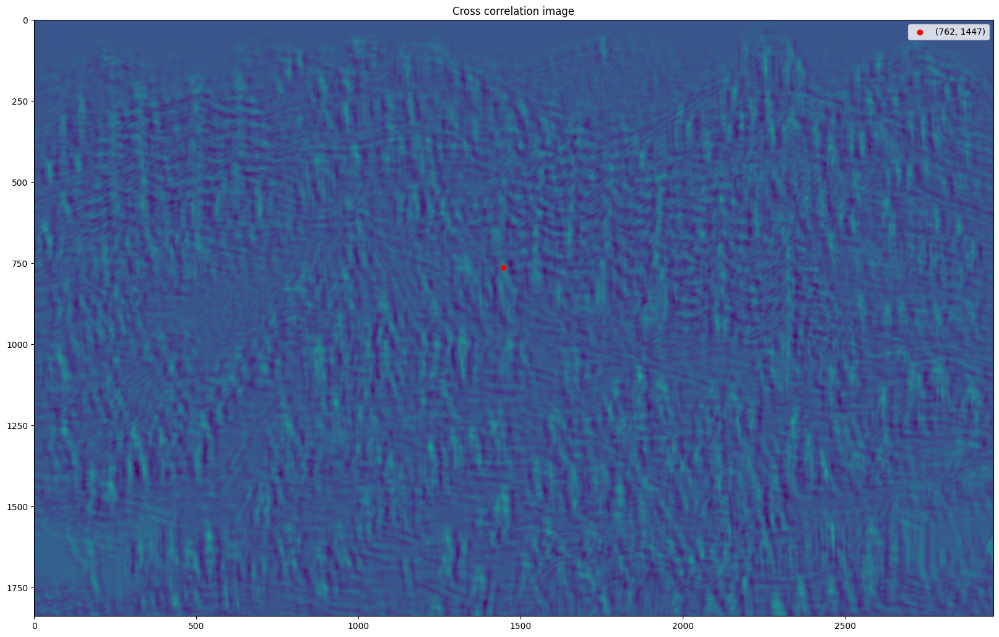

In [ ]:
import heapq
# Calculating top 5 correlation values.
minHeap = []
for i in range(len(corr)):
  for j in range(len(corr[i])):
    if (len(minHeap) > 5):
      heapq.heappop(minHeap)

    heapq.heappush(minHeap, [corr[i][j], (i, j)])

max_ = max(minHeap)
best = max_[1]

x, y = best
threshold_val = minHeap[0][0]

plt.figure(figsize=(20, 20))
# Generating heatmap with all the correlation values.
plt.imshow(corr)

plt.scatter(y, x, color='red', label=(x, y))
plt.title('Cross correlation image')
plt.legend()
plt.show()

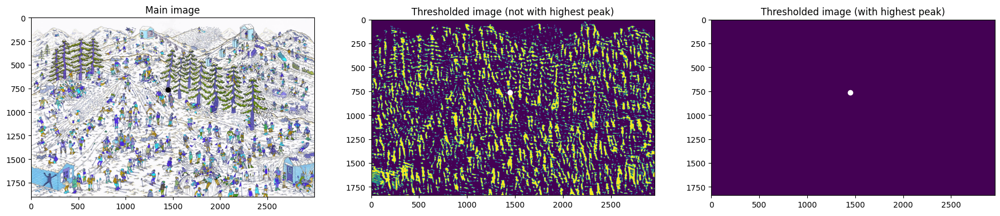

In [ ]:
# Plot the output of template matching along with a thresholded output with the peak
threshold_val = minHeap[0][0]

threshold_image = np.where(corr >= threshold_val, 255, 0)

max_threshold = max_[0]
new_threshold = np.where(threshold_image >= max_threshold, 255, 0)

plt.figure(figsize=(22, 20))

plt.subplot(1, 3, 1)
plt.imshow(main_image)
plt.scatter(best[1], best[0], color='black')
plt.title('Main image')

plt.subplot(1, 3, 2)
plt.imshow(threshold_image)
plt.scatter(best[1], best[0], color='white')
plt.title('Thresholded image (not with highest peak)')


plt.subplot(1, 3, 3)
plt.imshow(new_threshold)
plt.scatter(best[1], best[0], color='white')
plt.title('Thresholded image (with highest peak)')

plt.show()


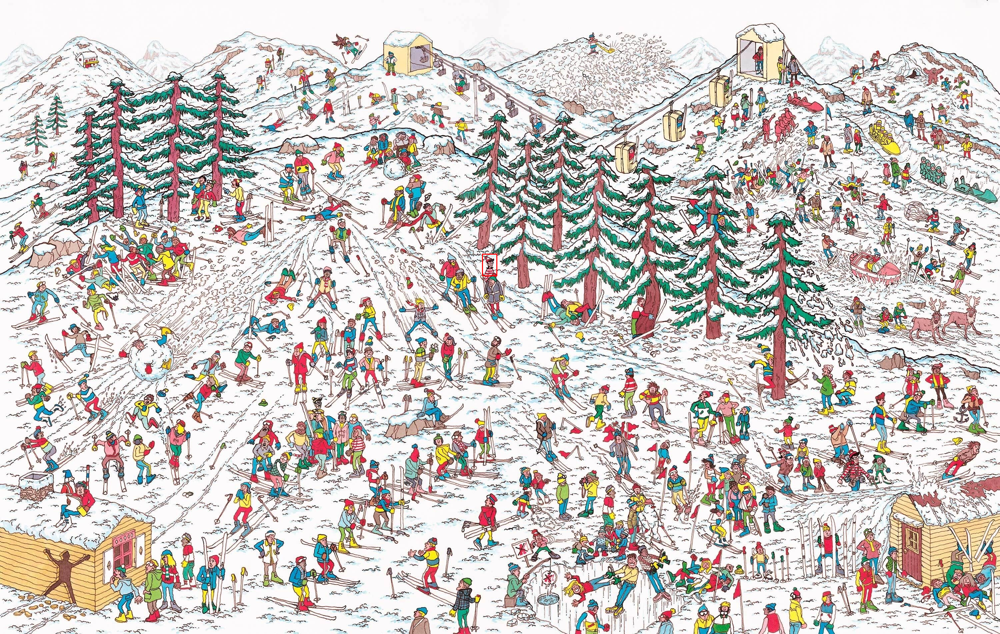

In [ ]:
# Plot the found peak on the original image and highlight it
x, y = best
cv2.rectangle(main_image, (y, x), (y+template_image.shape[1], x+template_image.shape[0]), (0, 0, 255), 2)

cv2_imshow(main_image)

**Discuss if the peak matches your expectations. Discuss the appearance of peaks at different threshold levels along with plotting them.**

> *Yes the peak matches the expectations from the template image. From the above image, after thresholding for top 5 correlation values, we see a white dot mark close to the center in the image highlighting there is a match. Note: The top 5 correlation values were all near each other and hence we see only one point with a higher intensity. Because there was only a single match, and hence we see only one white dot in the image. If we reduce the threshold value, and there are good matches, we will see more white dots in the image as we reduce the threshold indicating the close matches with the template image.*

# 4. Creative Section

In [ ]:
# Load "colored" image
main_image = cv2.imread('/content/WaldoBeach.jpg')
template_image = cv2.imread('/content/WaldoBeachtemp.jpg')

In [ ]:
cv2_imshow(template_image)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 14.5 µs


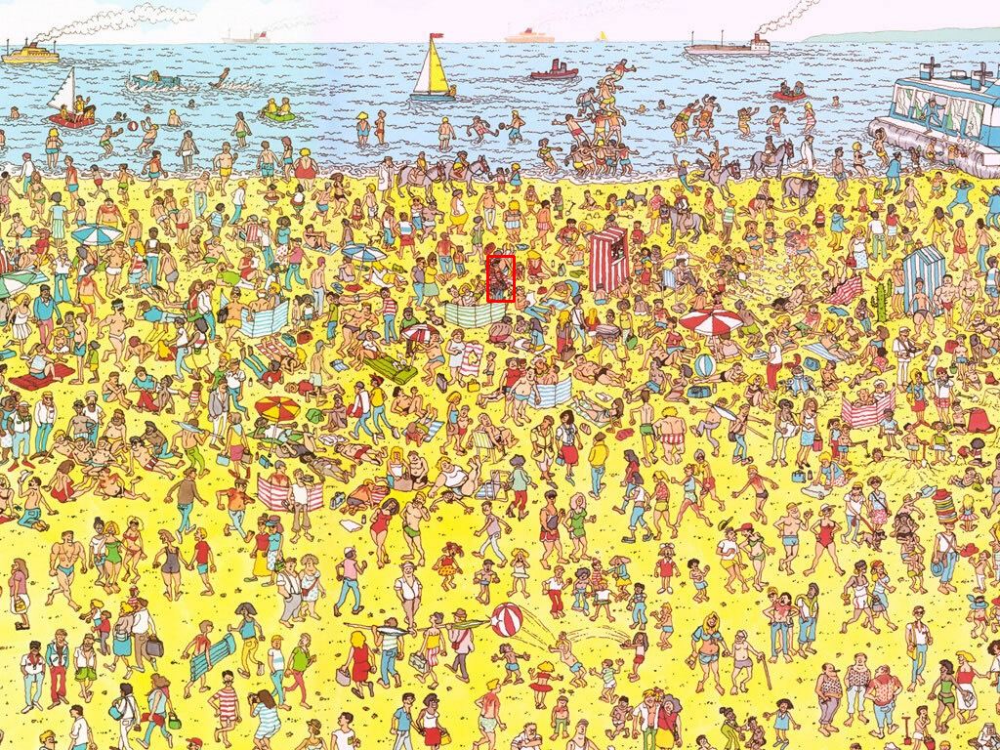

In [ ]:
%time
# Perform template matching here

def template_match(main_image, template_image):

  # Preprocessing the images by performing 0-mean operation
  image_normalized = main_image - np.mean(main_image)
  template_normalized = template_image - np.mean(template_image)

  def calculate_correlation(image, template):
    image_fft = np.fft.fft2(image)
    # Padding the image for multiplication purposes in the frequency domain
    padded_image = np.pad(template, ((0, image.shape[0] - template.shape[0]), (0, image.shape[1] - template.shape[1])))

    template_fft = np.fft.fft2(padded_image)

    # We mutltiply the fft image with the conjugate of the template to get a correlation match
    # Because of the advantage of the frequency space, we can calculate the correlation matrix quickly
    correlation = np.fft.ifft2(image_fft * np.conj(template_fft))
    correlation = np.abs(correlation)

    return correlation

  color_dimension = main_image.shape[2]

  # splitting the image channel for computing the cross correlation matrix
  corr_r = calculate_correlation(image_normalized[:, :, 0], template_normalized[:, :, 0])
  corr_b = calculate_correlation(image_normalized[:, :, 1], template_normalized[:, :, 1])
  corr_g = calculate_correlation(image_normalized[:, :, 2], template_normalized[:, :, 2])

  correlation_map = (corr_r + corr_b + corr_g) / color_dimension

  best_match = np.unravel_index(np.argmax(correlation_map), correlation_map.shape)

  return best_match

best_match_position = template_match(main_image, template_image)

x, y = best_match_position
cv2.rectangle(main_image, (y, x), (y+template_image.shape[1], x+template_image.shape[0]), (0, 0, 255), 2)

cv2_imshow(main_image)